In [1]:
from datetime import datetime

notebook_start = datetime.now()

In [2]:
import os

# this makes it so that the outputs of the predict methods have the id as a column
# instead of as the index
os.environ['NIXTLA_ID_AS_COL'] = '1'

In [3]:
import pandas as pd
# from google.colab import drive

# drive.mount('/content/drive')
# df = pd.read_csv('/content/drive/My Drive/TCC/m6dataset.csv')
df = pd.read_csv('m6dataset.csv')
df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003


In [4]:
TEST_ROWS = 7

# Splitting the dataframe into train and test sets
train_df = df.iloc[:-TEST_ROWS]
test_df = df.iloc[-TEST_ROWS:]
train_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
951,2024-08-12,190.179993,313.959991,97.139999,178.460007,128.759995,192.720657,404.540009,166.800003,209.360001,...,84.620003,89.849998,42.180000,123.650002,207.309998,78.750000,73.739998,149.410004,173.649994,118.049599
952,2024-08-13,191.229996,319.329987,98.129997,184.320007,130.089996,200.415924,408.260010,170.229996,211.750000,...,85.720001,88.980003,42.529999,124.949997,213.679993,79.110001,74.169998,151.220001,178.000000,116.918709
953,2024-08-14,193.000000,319.829987,97.239998,185.979996,131.089996,201.244339,419.869995,170.100006,213.520004,...,85.230003,89.500000,43.049999,125.459999,214.850006,79.470001,74.120003,151.759995,177.050003,118.000000
954,2024-08-15,193.399994,325.130005,96.559998,184.059998,132.949997,211.424820,424.070007,177.589996,214.679993,...,86.000000,90.570000,43.450001,127.150002,221.029999,80.290001,74.110001,152.710007,182.699997,118.730003


In [5]:
test_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
956,2024-08-17,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
957,2024-08-18,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003
962,2024-08-23,197.550003,333.269989,98.250000,193.009995,137.000000,202.669998,439.679993,177.039993,221.729996,...,87.500000,90.389999,44.430000,129.279999,223.960007,81.839996,75.419998,155.449997,187.869995,116.320000


In [6]:
df.columns

Index(['Date', 'ABBV', 'ACN', 'AEP', 'AIZ', 'ALLE', 'AMAT', 'AMP', 'AMZN',
       'AVB', 'AVY', 'AXP', 'BDX', 'BF-B', 'BMY', 'BR', 'CARR', 'CDW', 'CE',
       'CHTR', 'CNC', 'CNP', 'COP', 'CTAS', 'CZR', 'DG', 'DPZ', 'DXC', 'EWA',
       'EWC', 'EWG', 'EWH', 'EWJ', 'EWL', 'EWQ', 'EWT', 'EWU', 'EWY', 'EWZ',
       'FTV', 'GOOG', 'GPC', 'GSG', 'HIG', 'HIGH.L', 'HST', 'HYG', 'IAU',
       'ICLN', 'IEAA.L', 'IEF', 'IEFM.L', 'IEMG', 'IEUS', 'IEVL.L', 'IGF',
       'INDA', 'IUMO.L', 'IUVL.L', 'IVV', 'IWM', 'IXN', 'JPEA.L', 'JPM', 'KR',
       'LQD', 'MCHI', 'META', 'MVEU.L', 'OGN', 'PG', 'PPL', 'PRU', 'PYPL',
       'REET', 'ROL', 'ROST', 'SEGA.L', 'SHY', 'SLV', 'SPMV.L', 'TLT', 'UNH',
       'URI', 'V', 'VRSK', 'VXX', 'WRK', 'XLB', 'XLC', 'XLE', 'XLF', 'XLI',
       'XLK', 'XLP', 'XLU', 'XLV', 'XLY', 'XOM'],
      dtype='object')

In [7]:
# prompt: create a method for plotting df using an interactive line graph, one line for columns, starting from column 2, column 1 is the index, ignore column 0. the graph must show only the legend and value of the line where the mouse hovers over.
import plotly.express as px

def plot_df(df):
  df = df.set_index(df.columns[0])
  fig = px.line(df, x=df.index, y=df.columns[2:], hover_data={"variable":False})
  fig.update_traces(mode='lines', hovertemplate=None)
  # fig.update_layout(hovermode="x unified")
  fig.update_layout(
      title='M6 Dataset',
      xaxis_title='Days',
      yaxis_title='Adj. Values',
      hovermode='closest',  # Ensures that only the data point under the cursor is displayed
      showlegend=True       # Display legend
  )
  fig.show()

plot_df(df)

# NIXTLA

In [8]:
#!pip install neuralforecast

In [9]:
from neuralforecast import NeuralForecast
from ray.tune.search.hyperopt import HyperOptSearch
from neuralforecast.losses.pytorch import MAE
from ray import tune
import torch

In [10]:
#torch.set_float32_matmul_precision('medium' | 'high' | 'highest')
torch.set_float32_matmul_precision('high')

## Auto Models

In [11]:
import warnings
warnings.filterwarnings('ignore')

In [12]:
import neuralforecast.auto
from neuralforecast.auto import AutoNHITS, AutoRNN, AutoLSTM, AutoGRU, AutoTCN, AutoDeepAR, AutoDilatedRNN, AutoBiTCN
from neuralforecast.auto import AutoMLP, AutoNBEATS, AutoNBEATSx, AutoDLinear, AutoNLinear, AutoTiDE, AutoDeepNPTS
from neuralforecast.auto import AutoTFT, AutoVanillaTransformer, AutoInformer, AutoAutoformer, AutoFEDformer
from neuralforecast.auto import AutoPatchTST, AutoiTransformer, AutoTimesNet

horizont = 1

# --- CONFIGS ---

# Extract the default hyperparameter settings

#A. RNN-Based
rnn_config = AutoRNN.get_default_config(h = horizont, backend="ray")
lstm_config = AutoLSTM.get_default_config(h = horizont, backend="ray")
gru_config = AutoGRU.get_default_config(h = horizont, backend="ray")
tcn_config = AutoTCN.get_default_config(h = horizont, backend="ray")
deep_ar_config = AutoDeepAR.get_default_config(h = horizont, backend="ray")
dilated_rnn_config = AutoDilatedRNN.get_default_config(h = horizont, backend="ray")
bitcn_config = AutoBiTCN.get_default_config(h = horizont, backend="ray")

#B. MLP-Based
mlp_config = AutoMLP.get_default_config(h = horizont, backend="ray")
nbeats_config = AutoNBEATS.get_default_config(h = horizont, backend="ray")
nbeatsx_config = AutoNBEATSx.get_default_config(h = horizont, backend="ray")
nhits_config = AutoNHITS.get_default_config(h = horizont, backend="ray")
dlinear_config = AutoDLinear.get_default_config(h = horizont, backend="ray")
nlinear_config = AutoNLinear.get_default_config(h = horizont, backend="ray")
tide_config = AutoTiDE.get_default_config(h = horizont, backend="ray")
deep_npts_config = AutoDeepNPTS.get_default_config(h = horizont, backend="ray")

#C. Transformer models
tft_config = AutoTFT.get_default_config(h = horizont, backend="ray")
vanilla_config = AutoVanillaTransformer.get_default_config(h = horizont, backend="ray")
informer_config = AutoInformer.get_default_config(h = horizont, backend="ray")
autoformer_config = AutoAutoformer.get_default_config(h = horizont, backend="ray")
fedformer_config = AutoFEDformer.get_default_config(h = horizont, backend="ray")
patch_tst_config = AutoPatchTST.get_default_config(h = horizont, backend="ray")

itransformer_config = AutoiTransformer.get_default_config(h = horizont, n_series=1, backend="ray")

#D. CNN Based
timesnet_config = AutoTimesNet.get_default_config(h = horizont, backend="ray")

In [13]:
# --- MODELS ---
#A. RNN-Based
rnn_model = AutoRNN(h=horizont, config=rnn_config)
lstm_model = AutoLSTM(h=horizont, config=lstm_config)
gru_model = AutoGRU(h=horizont, config=gru_config)
tcn_model = AutoTCN(h=horizont, config=tcn_config)
deep_ar_model = AutoDeepAR(h=horizont, config=deep_ar_config)
dilated_rnn_model = AutoDilatedRNN(h=horizont, config=dilated_rnn_config)
bitcn_model = AutoBiTCN(h=horizont, config=bitcn_config)

#B. MLP-Based
mlp_model = AutoMLP(h=horizont, config=mlp_config)
nbeats_model = AutoNBEATS(h=horizont, config=nbeats_config)
nbeatsx_model = AutoNBEATSx(h=horizont, config=nbeats_config)
nhits_model = AutoNHITS(h=horizont, config=nhits_config)
dlinear_model = AutoDLinear(h=horizont, config=dlinear_config)
nlinear_model = AutoNLinear(h=horizont, config=nlinear_config)
tide_model = AutoTiDE(h=horizont, config=tide_config)
deep_npts_model = AutoDeepNPTS(h=horizont, config=deep_npts_config)

#C. Transformer models
tft_model = AutoTFT(h=horizont, config=tft_config)
vanilla_model = AutoVanillaTransformer(h=horizont, config=vanilla_config)
informer_model = AutoInformer(h=horizont, config=informer_config)
autoformer_model = AutoAutoformer(h=horizont, config=autoformer_config)
fedformer_model = AutoFEDformer(h=horizont, config=fedformer_config)
patch_tst_model = AutoPatchTST(h=horizont, config=patch_tst_config)

itransformer_model = AutoiTransformer(h=horizont, n_series=1, config=itransformer_config)

#D. CNN Based
timesnet_model = AutoTimesNet(h=horizont, config=timesnet_config)

In [14]:
MODELS = {
  'lstm': lstm_model,
  'mlp': mlp_model,
  'dlinear': dlinear_model,
  'nlinear': nlinear_model,
  'informer': informer_model,
  'autoformer': autoformer_model,
  'fedformer': fedformer_model
}

In [15]:
model_name = 'dlinear'
frequency = 'D' # 'B' business day frequency (https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases)

models = [
    MODELS[model_name]
    #rnn_model,
    #lstm_model,  # ......... 1
    #gru_model,
    #tcn_model,
    #deep_ar_model,
    #dilated_rnn_model,
    #bitcn_model,
    #mlp_model,  # .......... 2
    #nbeats_model,
    #nbeatsx_model,
    #nhits_model,
    #dlinear_model,  # ...... 3
    #nlinear_model,  # ...... 4
    #tide_model,
    #deep_npts_model,
    #tft_model,
    #vanilla_model,
    #informer_model,  # ..... 5
    #autoformer_model,  # ... 6
    #fedformer_model,  # .... 7
    #patch_tst_model,
    #itransformer_model,
    #timesnet_model
    ]
nf = NeuralForecast(
      models=models,
      freq=frequency
    )

In [16]:
def convert_nixtla(df):
  ndf = pd.DataFrame(columns=['unique_id', 'ds', 'y'])

  for col in df.columns[1:]:
    temp = df[['Date', col]].copy()
    temp['unique_id'] = col
    temp.rename(columns={'Date':'ds', col: 'y'}, inplace=True)
    ndf = pd.concat([ndf, temp], ignore_index=True)
  ndf['ds']=pd.to_datetime(ndf['ds'])

  return ndf

In [17]:
%%time
start_time = datetime.now()

for i in range(0, TEST_ROWS):
  print('--- FORECASTING ' + str(i+1) + ' ---')

  ndf=convert_nixtla(train_df)
  nf.fit(df=ndf)
  pred = nf.predict()

  # transposing the prediction and adjustin columns
  date_value = pd.to_datetime(pred['ds'].iloc[0]).strftime('%Y-%m-%d')
  pred.set_index('unique_id', inplace=True)
  predt = pred.drop(columns=['ds']).T
  predt.insert(0, 'Date', date_value)
  try:
      preds = pd.concat([preds, predt])
  except NameError:
      preds = predt

  # prompt: concat row i from test_df at the end of train_df
  train_df = pd.concat([train_df, test_df.iloc[[i]]])

stop_time = datetime.now()
elapsed_time = stop_time - start_time

print(f"Cell started at: {start_time}")
print(f"Cell stopped at: {stop_time}")
print(f"Elapsed time: {elapsed_time}")

(pid=326037) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=326037)   return to

Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 99.57it/s, v_num=0, train_loss_step=4.250, train_loss_epoch=5.180] 
(_train_tune pid=326037) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=326037) 
(_train_tune pid=326037) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=326037) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 269.00it/s]
(_train_tune pid=326037) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 103.19it/s, v_num=0, train_loss_step=4.940, train_loss_epoch=5.240, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 102.91it/s, v_num=0, train_loss_step=5.450, train_loss_epoch=5.480, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 101.02it/s, v_num=0, train_loss_step=4.720, train_loss_epoch=5.310, valid_loss=1.020]
Validation: |          | 0/? [00:00<?

(_train_tune pid=326037) `Trainer.fit` stopped: `max_steps=600.0` reached.


(_train_tune pid=326037) 
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 38.24it/s, v_num=0, train_loss_step=4.680, train_loss_epoch=4.680, valid_loss=1.040]


(pid=326344) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=326344)   return to

Epoch 49: 100%|██████████| 2/2 [00:00<00:00, 148.94it/s, v_num=0, train_loss_step=2.900, train_loss_epoch=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 2/2 [00:00<00:00, 143.87it/s, v_num=0, train_loss_step=0.778, train_loss_epoch=1.370, valid_loss=2.050]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 149: 100%|██████████| 2/2 [00:00<00:00, 147.45it/s, v_num=0, train_loss_step=1.600, train_loss_epoch=1.210, valid_loss=1.240]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 2/2 [00:00<00:00, 149.25it/s, v_num=0, train_loss_step=3.190, train_loss_epoch=2.550, valid_loss=1.110]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 249: 100%|██████████| 2/2 [00:00<00:00, 147.22it/s, v_num=0, train_loss_step=0.865, train_loss_epoch=1.390, valid_loss=1.010]
(_train_tune pid=326344) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=326344) 
Validation DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]
(_train_tune pi

(_train_tune pid=326344) `Trainer.fit` stopped: `max_steps=1000.0` reached.
(pid=326650) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub f

Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 157.96it/s, v_num=0, train_loss_step=1.23e+3, train_loss_epoch=4.43e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 4/4 [00:00<00:00, 261.23it/s]
                                                                       
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 152.57it/s, v_num=0, train_loss_step=5.29e+3, train_loss_epoch=1.93e+3, valid_loss=1.200]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 150.65it/s, v_num=0, train_loss_step=6.23e+3, train_loss_epoch=4.79e+3, valid_loss=1.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/4 [00:00<?, ?it/s]
(_train_tune pid=326650) 
(_train_tune pid=326650) 
Validation DataLoader 0:  25%|██▌       | 1/4 [00:00<00:00, 239.01it/s]
(_train_tune pid=326650) 
Epoch 99: 100%|██████████| 4/4 [00:00<00:00, 137.65it/s, v_num=0, train_loss_step=1.36e+3, train_loss_epoch=2168.0, va

(_train_tune pid=326650) `Trainer.fit` stopped: `max_steps=1300.0` reached.


Epoch 324: 100%|██████████| 4/4 [00:00<00:00, 140.23it/s, v_num=0, train_loss_step=134.0, train_loss_epoch=2.11e+3, valid_loss=1.110]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 324: 100%|██████████| 4/4 [00:00<00:00, 75.29it/s, v_num=0, train_loss_step=134.0, train_loss_epoch=1.88e+3, valid_loss=1.110] 


(pid=327019) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=327019)   return to

Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 167.72it/s, v_num=0, train_loss_step=0.510, train_loss_epoch=1.290]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 169.77it/s, v_num=0, train_loss_step=4.380, train_loss_epoch=1.100, valid_loss=1.050]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  75%|███████▌  | 3/4 [00:00<00:00, 267.38it/s]
(_train_tune pid=327019) 
Validation DataLoader 0: 100%|██████████| 4/4 [00:00<00:00, 271.25it/s]
(_train_tune pid=327019) 
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 164.00it/s, v_num=0, train_loss_step=0.188, train_loss_epoch=0.813, valid_loss=1.010]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=327019) 
Validation DataLoader 0:   0%|          | 0/4 [00:00<?, ?it/s]
(_train_tune pid=327019) 
Validation DataLoader 0:  25%|██▌       | 1/4 [00:00<00:00, 276.98it/s]
(_train_tune pid=327019) 
Validation DataLoader 0:  5

(_train_tune pid=327019) `Trainer.fit` stopped: `max_steps=800.0` reached.
(pid=327305) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub fo

Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 156.41it/s, v_num=0, train_loss_step=1.32e+3, train_loss_epoch=3.93e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  50%|█████     | 2/4 [00:00<00:00, 239.21it/s]
(_train_tune pid=327305) 
Validation DataLoader 0:  75%|███████▌  | 3/4 [00:00<00:00, 223.76it/s]
(_train_tune pid=327305) 
Validation DataLoader 0: 100%|██████████| 4/4 [00:00<00:00, 226.30it/s]
(_train_tune pid=327305) 
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 155.49it/s, v_num=0, train_loss_step=3.01e+3, train_loss_epoch=2.19e+3, valid_loss=1.100]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 150.71it/s, v_num=0, train_loss_step=1.98e+3, train_loss_epoch=2.42e+3, valid_loss=1.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 4/4 [00:00<00:00, 150.72it/s, v_num=0, train_loss_step=5e+3, train_loss_epoch=1.64e+3, valid_loss=0.957]   
(_train_tune pid=327305) 
Validation: |       

(_train_tune pid=327305) `Trainer.fit` stopped: `max_steps=1500.0` reached.
(pid=327697) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub f

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 111.05it/s, v_num=0, train_loss_step=238.0, train_loss_epoch=249.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 110.84it/s, v_num=0, train_loss_step=253.0, train_loss_epoch=213.0, valid_loss=310.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 112.19it/s, v_num=0, train_loss_step=222.0, train_loss_epoch=212.0, valid_loss=297.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 93.06it/s, v_num=0, train_loss_step=225.0, train_loss_epoch=240.0, valid_loss=284.0] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 110.51it/s, v_num=0, train_loss_step=216.0, train_loss_epoch=227.0, valid_loss=271.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 105.76it/s, v_num=0, train_loss_step=228.0, train_loss_epoch=216.0, valid_loss=258.

(_train_tune pid=327697) `Trainer.fit` stopped: `max_steps=1000.0` reached.
(pid=328088) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub f

Epoch 49: 100%|██████████| 2/2 [00:00<00:00, 139.58it/s, v_num=0, train_loss_step=4.19e+3, train_loss_epoch=2.12e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 2/2 [00:00<00:00, 138.13it/s, v_num=0, train_loss_step=612.0, train_loss_epoch=1.12e+3, valid_loss=0.973]  
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 2/2 [00:00<00:00, 284.34it/s]
(_train_tune pid=328088) 
Epoch 149: 100%|██████████| 2/2 [00:00<00:00, 139.60it/s, v_num=0, train_loss_step=2.04e+3, train_loss_epoch=3.06e+3, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 2/2 [00:00<00:00, 131.77it/s, v_num=0, train_loss_step=261.0, train_loss_epoch=972.0, valid_loss=1.030]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 249: 100%|██████████| 2/2 [00:00<00:00, 139.56it/s, v_num=0, train_loss_step=3.180, train_loss_epoch=784.0, valid_loss=1.030]    
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100

(_train_tune pid=328088) `Trainer.fit` stopped: `max_steps=1400.0` reached.


Epoch 699: 100%|██████████| 2/2 [00:00<00:00, 137.87it/s, v_num=0, train_loss_step=2.02e+3, train_loss_epoch=746.0, valid_loss=1.030]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 2/2 [00:00<00:00, 62.93it/s, v_num=0, train_loss_step=2.02e+3, train_loss_epoch=1.46e+3, valid_loss=1.030]


(pid=328478) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=328478)   return to

Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 102.80it/s, v_num=0, train_loss_step=7.050, train_loss_epoch=5.580]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 99.22it/s, v_num=0, train_loss_step=4.130, train_loss_epoch=6.890, valid_loss=1.710] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 97.69it/s, v_num=0, train_loss_step=7.070, train_loss_epoch=4.660, valid_loss=1.700] 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=328478) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 102.64it/s, v_num=0, train_loss_step=4.440, train_loss_epoch=2.790, valid_loss=1.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 94.00it/s, v_num=0, train_loss_step=3.220, train_loss_epoch=6.020, valid_loss=1.680] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 103.67

(_train_tune pid=328478) `Trainer.fit` stopped: `max_steps=1400.0` reached.
(pid=328955) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub f

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 104.10it/s, v_num=0, train_loss_step=1.110, train_loss_epoch=0.946]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 106.00it/s, v_num=0, train_loss_step=1.110, train_loss_epoch=0.932, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 105.28it/s, v_num=0, train_loss_step=1.000, train_loss_epoch=0.927, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 104.13it/s, v_num=0, train_loss_step=0.866, train_loss_epoch=0.952, valid_loss=1.030]
(_train_tune pid=328955) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=328955) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=328955) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 288.94it/s]
(_train_tune pid=328955) 
                                                                    

(_train_tune pid=328955) `Trainer.fit` stopped: `max_steps=1000.0` reached.
(pid=329374) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub f

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 103.55it/s, v_num=0, train_loss_step=4.020, train_loss_epoch=5.690]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=329374) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 108.13it/s, v_num=0, train_loss_step=3.490, train_loss_epoch=3.570, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 106.10it/s, v_num=0, train_loss_step=4.870, train_loss_epoch=3.260, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 108.66it/s, v_num=0, train_loss_step=3.430, train_loss_epoch=3.440, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 105.74it/s, v_num=0, train_loss_step=3.200, train_loss_epoch=3.290, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 309.59it/s]
                               

2024-09-04 21:49:39,737	INFO tune.py:1009 -- Wrote the latest version of all result files and experiment state to '/home/hal/ray_results/_train_tune_2024-09-04_21-47-08' in 0.0164s.
Seed set to 14
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type          | Params | Mode 
--------------------------------------------------------
0 | loss          | MAE           | 0      | eval 
1 | padder_train  | ConstantPad1d | 0      | train
2 | scaler        | TemporalNorm  | 0      | train
3 | decomp        | SeriesDecomp  | 0      | train
4 | linear_trend  | Linear        | 4      | train
5 | linear_season | Linear        | 4      | train
--------------------------------------------------------
8         Trainable params
0         Non-trainable params
8         Total params
0.000     Total estimated model params size (MB)
7         Modules in train mode
1         M

Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 107.84it/s, v_num=0, train_loss_step=4.510, train_loss_epoch=5.290, valid_loss=1.030]
(_train_tune pid=329374) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=329374) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=329374) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 294.65it/s]


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

(_train_tune pid=329374) 
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 41.08it/s, v_num=0, train_loss_step=4.510, train_loss_epoch=4.510, valid_loss=1.030] 


(_train_tune pid=329374) `Trainer.fit` stopped: `max_steps=700.0` reached.


Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

`Trainer.fit` stopped: `max_steps=1400.0` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                                 …

Cell started at: 2024-09-04 21:30:57.658006
Cell stopped at: 2024-09-04 21:49:53.754086
Elapsed time: 0:18:56.096080
CPU times: user 1min 38s, sys: 8.62 s, total: 1min 46s
Wall time: 18min 56s


In [18]:
import IPython
IPython.display.Audio("file_example_MP3_1MG.mp3", autoplay=True)

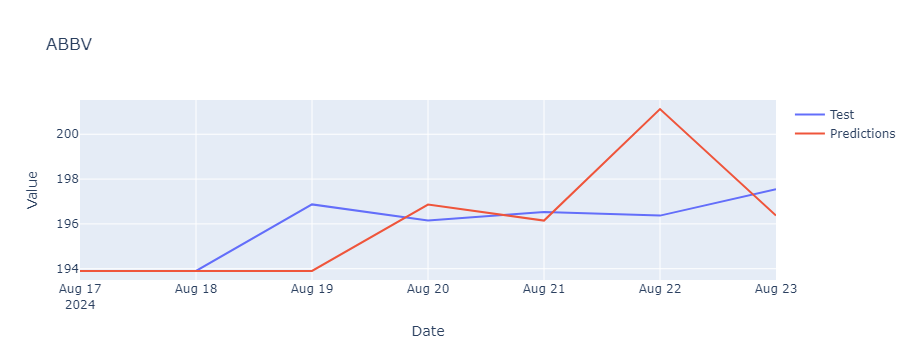

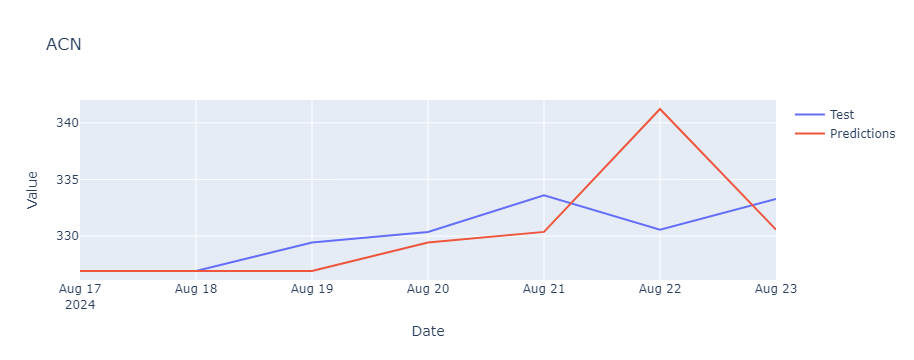

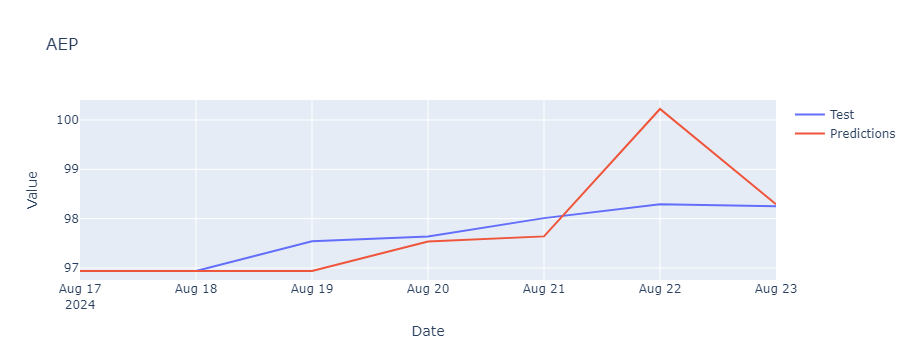

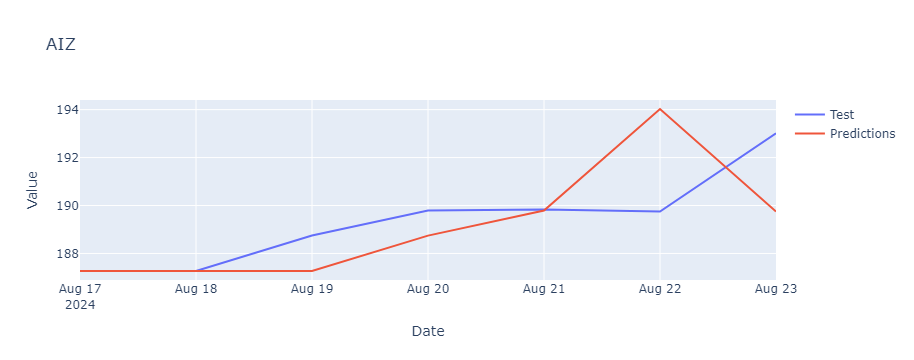

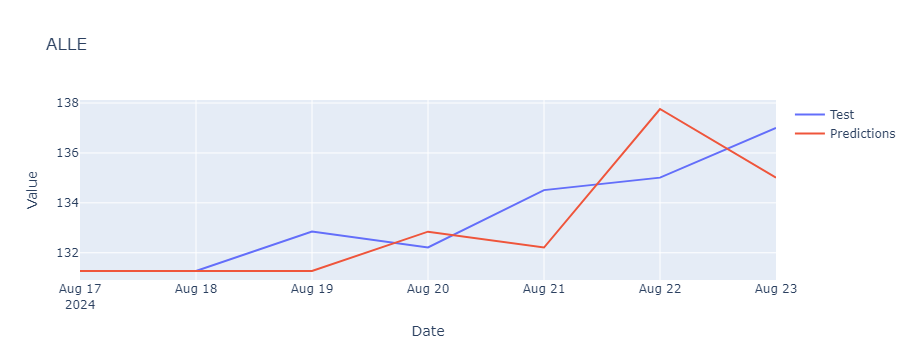

...

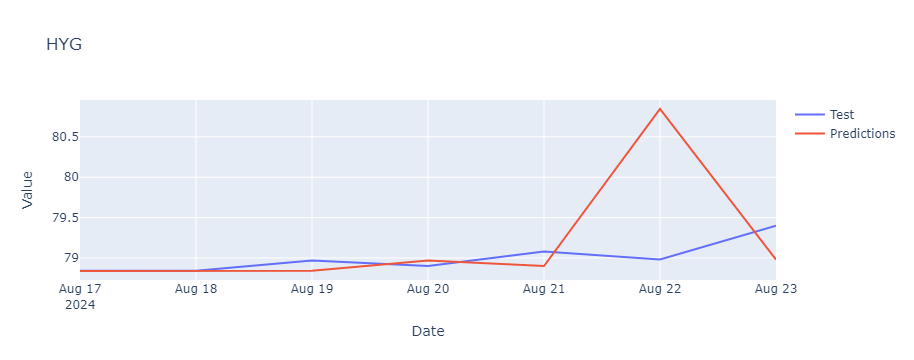

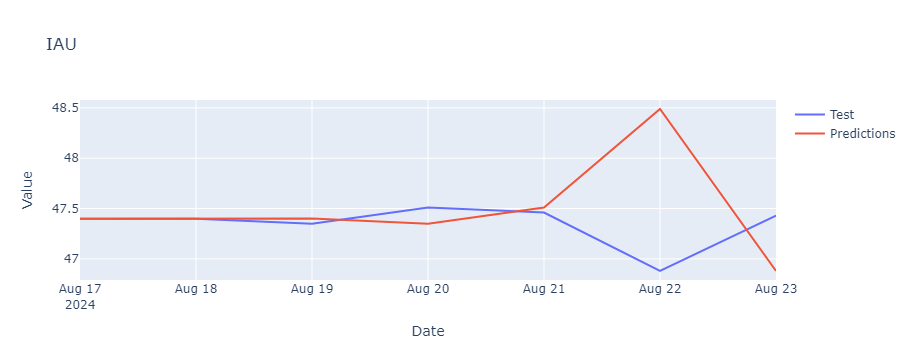

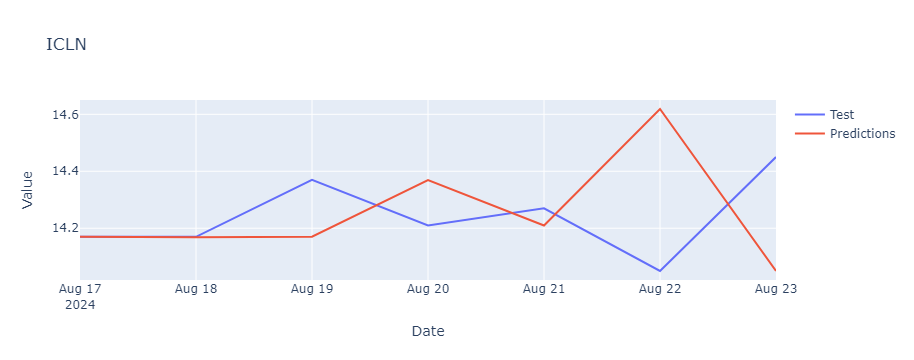

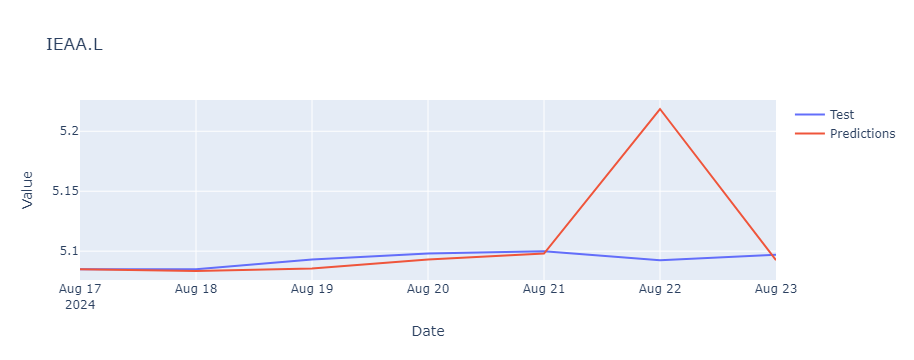

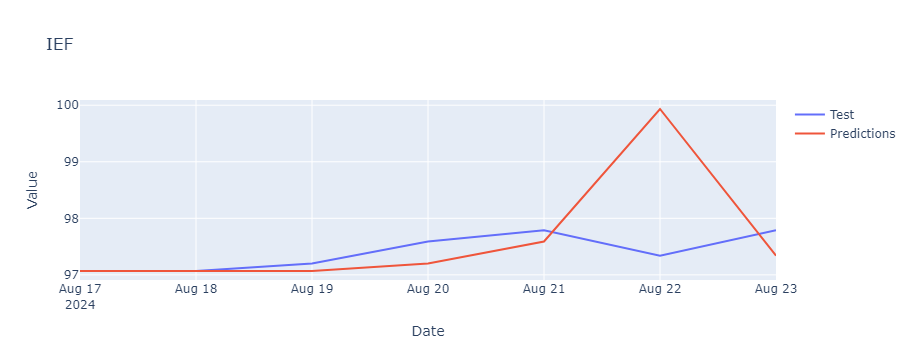

In [19]:
# prompt: plot columns 1 from test_df and preds, the title is the column name

import plotly.graph_objects as go

def plot_pred_vs_test(test_df, preds):
  for col in test_df.columns[1:]:
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=test_df['Date'], y=test_df[col], mode='lines', name='Test'))
    fig.add_trace(go.Scatter(x=preds['Date'], y=preds[col], mode='lines', name='Predictions'))
    fig.update_layout(title=col, xaxis_title='Date', yaxis_title='Value')
    fig.show()

plot_pred_vs_test(test_df, preds)

In [20]:
preds

unique_id,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
AutoDLinear,2024-08-17,193.899918,326.919922,96.939926,187.269928,131.269928,207.502258,431.389923,177.059921,215.209930,...,86.259926,90.469925,43.769920,126.969925,221.399918,80.509926,74.439926,152.869919,183.129929,118.169922
AutoDLinear,2024-08-18,193.898438,326.918457,96.938454,187.268448,131.268448,207.500778,431.388458,177.058441,215.208450,...,86.258453,90.468452,43.768448,126.968452,221.398438,80.508453,74.438454,152.868439,183.128448,118.168449
AutoDLinear,2024-08-19,193.900452,326.920471,96.940460,187.270462,131.270462,207.502792,431.390472,177.060455,215.210464,...,86.260460,90.470459,43.770462,126.970459,221.400452,80.510460,74.440460,152.870453,183.130463,118.170456
AutoDLinear,2024-08-20,196.860321,329.431793,97.538048,188.745178,132.844864,210.526642,435.327118,178.216217,216.037292,...,87.236809,91.078018,44.009216,127.737488,225.038116,80.779121,74.928406,153.796967,185.372681,118.528824
AutoDLinear,2024-08-21,196.148727,330.371796,97.640190,189.791977,132.208878,205.757324,434.027710,178.881271,216.581039,...,87.179893,88.675804,43.869755,127.389389,224.258606,81.180763,74.769714,154.421188,185.209717,114.573090
AutoDLinear,2024-08-22,201.127075,341.221069,100.221939,194.026505,137.760895,214.044510,443.469513,184.171158,221.850830,...,89.570610,91.013641,44.789677,131.102249,230.922760,83.550766,77.035309,158.112183,191.977676,116.627281
AutoDLinear,2024-08-23,196.369812,330.567780,98.289986,189.749954,135.009430,200.195526,433.700165,176.127960,218.020218,...,86.889610,89.060036,44.050110,127.999687,220.387405,81.609779,75.209793,154.779953,184.307953,114.730530


In [21]:
test_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
956,2024-08-17,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
957,2024-08-18,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003
962,2024-08-23,197.550003,333.269989,98.250000,193.009995,137.000000,202.669998,439.679993,177.039993,221.729996,...,87.500000,90.389999,44.430000,129.279999,223.960007,81.839996,75.419998,155.449997,187.869995,116.320000


In [22]:
# prompt: compare test_df and preds columns MAE, RSME and POCID, put results in a pandas dataframe

from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

def pocid(actual, forecast):
  actual = np.array(actual)
  forecast = np.array(forecast)
  sum_abs_diff = np.sum(np.abs(actual - forecast))
  sum_actual = np.sum(actual)
  return (sum_abs_diff / sum_actual) * 100

results = []
for col in test_df.columns[1:]:
  mae = mean_absolute_error(test_df[col], preds[col])
  rmse = np.sqrt(mean_squared_error(test_df[col], preds[col]))
  pocid_val = pocid(test_df[col], preds[col])
  results.append([col, mae, rmse, pocid_val])

results_df = pd.DataFrame(results, columns=['Column', 'MAE', 'RMSE', 'POCID'])
results_df

,Column,MAE,RMSE,POCID
0,ABBV,1.428578,2.187327,0.729254
1,ACN,2.862980,4.446454,0.867161
2,AEP,0.434979,0.778331,0.445408
3,AIZ,1.442936,2.144710,0.761921
4,ALLE,1.322660,1.678561,0.991160
...,...,...,...,...
93,XLP,0.484609,0.788723,0.597062
94,XLU,0.459340,0.748512,0.613025
95,XLV,0.830750,1.356025,0.539013
96,XLY,2.283408,3.423559,1.232771


In [23]:
notebook_stop = datetime.now()

print(f"Notebook started at: {notebook_start}")
print(f"Notebook stopped at: {notebook_stop}")

exec_df = pd.DataFrame({
  'Model': [model_name],
  'Cell Start': [start_time],
  'Cell Stop': [stop_time],
  'Cell Elapsed': [elapsed_time],
  'Note Start': [notebook_start],
  'Note Stop': [notebook_stop]
})

Notebook started at: 2024-09-04 21:30:52.136495
Notebook stopped at: 2024-09-04 21:49:54.408693


In [24]:
# prompt: save results_df into the TCC drive named autoarima.csv
preds.to_csv('./results/' + model_name + '-with_update-pred.csv', index=False)
test_df.to_csv('./results/' + model_name + '-with_update-val.csv', index=False)
results_df.to_csv('./results/' + model_name + '-with_update-metrics.csv', index=False)
exec_df.to_csv('./results/' + model_name + '-with_update-exec_time.csv', index=False)